<a href="https://colab.research.google.com/github/Loxsos/Regresion-Lineal-Simple-y-Multipele/blob/main/Regresion_Lineal_price_vs_host_acceptance_rate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv('https://drive.google.com/uc?export=download&id=1pkLk2s89-Etn7zIuYV88L_FvDH3sI8qx')
df.head()

,Unnamed: 0,source,name,description,neighborhood_overview,host_name,host_since,host_location,host_about,host_response_time,...,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta
0,0,city scrape,Nice room with superb city view,Our cool and comfortable one bedroom apartment...,It is very center of Bangkok and easy access t...,Nuttee,08/05/2010,"Bangkok, Thailand","Hi All, I am nuttee patranavik from Bangkok, T...",within an hour,...,0.0,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95
1,1,previous scrape,"Easy going landlord,easy place",Our cool and comfortable one bedroom apartment...,It is very center of Bangkok and easy access t...,Emy,08/05/2010,"Bangkok, Thailand","Hi All, I am nuttee patranavik from Bangkok, T...",within an hour,...,0.0,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70
2,2,previous scrape,modern-style apartment in Bangkok,A modern-style apartment situated in a cool ne...,Ramkumheang neigbourhood - hip place with food...,Familyroom,12/05/2010,"Bangkok, Thailand",Welcome to Familyroom Apartment.\r\n\r\nA Chic...,within an hour,...,0.0,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70
3,3,city scrape,Spacious one bedroom at The Kris Condo Bldg. 3,Cozy and clean apartment at MRT Sutthisarn sta...,"There is McDonald's, Au bon Pain and Max Value...",Sirilak,27/06/2010,"Bangkok, Thailand",from Bangkok but I'm in and out of the city a ...,within an hour,...,0.0,4.83,5.00,4.67,4.50,4.83,4.83,5.00,0.06,5.00
4,4,city scrape,Condo with Chaopraya River View,at a size of 25sqm for your vacation in BKK.<b...,"There is McDonald's, Au bon Pain and Max Value...",Athitaya,03/09/2010,"Bangkok, Thailand","Full-time legal consultant from Bangkok, Thail...",within an hour,...,0.0,5.00,5.00,5.00,5.00,5.00,5.00,5.00,0.01,5.00


In [4]:
df = df[df['room_type'] == 'Entire home/apt']

In [5]:
df['host_response_rate'] = df['host_response_rate'].str.rstrip('%').astype(float) / 100

In [6]:
df['price'] = df['price'].str.replace('$', '').str.replace(',', '').astype(float)


<ipython-input-7-ad6dc1613b72>:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


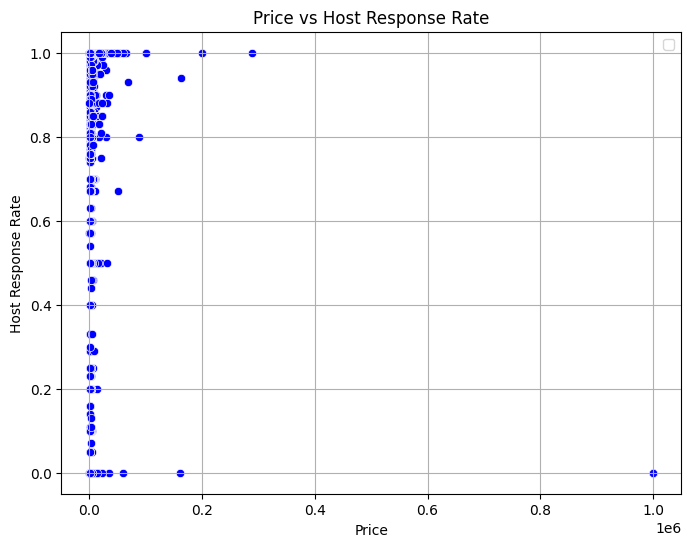

In [7]:
from turtle import color

plt.figure(figsize=(8, 6))
sns.scatterplot(x='price', y='host_response_rate', color='blue', data=df)
plt.title('Price vs Host Response Rate')
plt.xlabel('Price')
plt.ylabel('Host Response Rate')
plt.legend()
plt.grid(True)
plt.show()

In [8]:
indep= df[['host_response_rate']] * 100
dep = df[['price']] / 1000

In [9]:
from sklearn.linear_model import LinearRegression

model = LinearRegression()

In [10]:
model.fit(indep, dep)

LinearRegression()

In [11]:
type(model)

sklearn.linear_model._base.LinearRegression

In [12]:
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['host_response_rate'], dtype=object),
 'n_features_in_': 1,
 'coef_': array([[-0.08560987]]),
 'rank_': 1,
 'singular_': array([2177.22014672]),
 'intercept_': array([10.8209685])}

In [13]:
m = model.coef_
b = model.intercept_
print('Pendiente:', m)
print('Intercepto:', b)

# Entonce, el modelo lineal sería:
print(f'y = {m[0]}x + {b}')

Pendiente: [[-0.08560987]]
Intercepto: [10.8209685]
y = [-0.08560987]x + [10.8209685]


In [14]:
r2 = model.score(indep, dep)
r2

0.00797456552558018

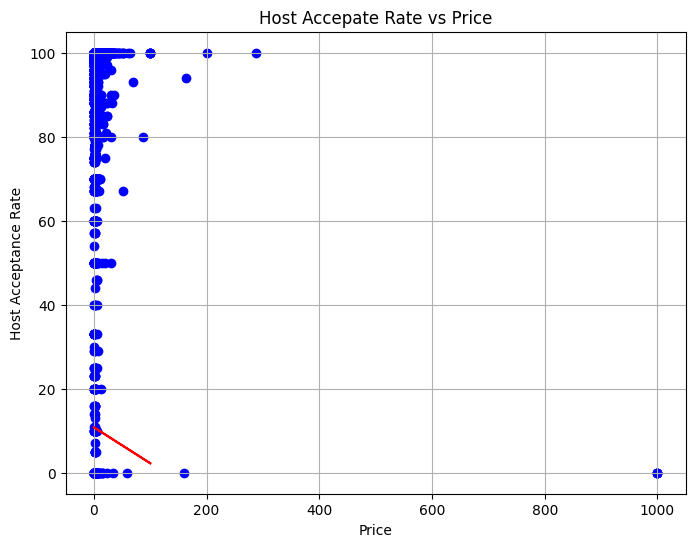

In [15]:
plt.figure(figsize=(8, 6))
plt.scatter(dep, indep, color='blue')
plt.plot(indep, model.predict(indep), color='red')
plt.title('Host Accepate Rate vs Price')
plt.xlabel('Price')
plt.ylabel('Host Acceptance Rate')
plt.grid(True)
plt.show()

In [16]:
yPred = model.predict(df[['host_response_rate']])
yPred

array([[10.73535863],
       [10.75676109],
       [10.8209685 ],
       ...,
       [10.73535863],
       [10.73535863],
       [10.73535863]])

In [17]:
df['Predicciones'] = yPred
df.head()

,Unnamed: 0,source,name,description,neighborhood_overview,host_name,host_since,host_location,host_about,host_response_time,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones
0,0,city scrape,Nice room with superb city view,Our cool and comfortable one bedroom apartment...,It is very center of Bangkok and easy access t...,Nuttee,08/05/2010,"Bangkok, Thailand","Hi All, I am nuttee patranavik from Bangkok, T...",within an hour,...,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95,10.735359
8,8,city scrape,"Cozy and spacious 1BR with great view, LT rent","The cozy one bed room apartment, conveniently ...","Charoen krung street, River pier, Iconsiam, Su...",Jean,27/10/2010,"Nonthaburi, Thailand","I love traveling and experience local culture,...",within a few hours,...,4.88,4.71,4.82,4.81,4.69,4.50,4.80,0.11,4.71,10.756761
9,9,city scrape,Central Bangkok 3 Bedroom Apartment,We are Airbnb Super Hosts. Book our apartment ...,Sukhumvit Rd is the shopping and restaurant di...,Henry,30/04/2011,"Bangkok, Thailand",Hello!\r\n\r\nOur collection of privately owne...,a few days or more,...,4.77,4.84,4.85,4.86,4.89,4.86,4.76,0.93,4.84,10.820968
13,13,city scrape,Studio near Chula University/Silom walk to MRT,A centrally located studio apartment with wifi...,It's central yet very local - you'll find easi...,Gael,01/12/2009,"Ko Samui, Thailand","I'm french, living in Samui and Bangkok.\r\n\r...",within a few hours,...,4.80,4.56,4.80,4.90,4.90,4.35,4.80,0.47,4.56,10.735359
14,14,previous scrape,Nice and Cozy Room @ Sathorn Area,A centrally located studio apartment with wifi...,It's central yet very local - you'll find easi...,Wirat,01/07/2011,"Bangkok, Thailand",Nice and Cozy Room @ Sathorn Area. \r\nOne Bed...,within a few hours,...,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70,10.735359


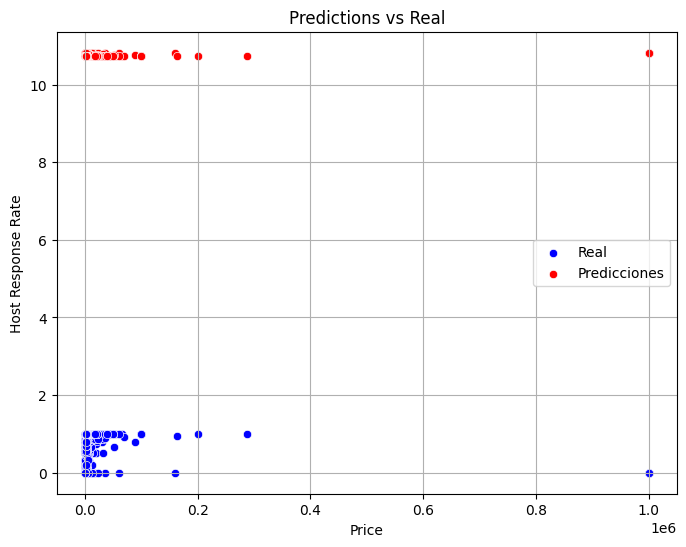

In [18]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='price', y='host_response_rate', color='blue', data=df, label='Real')
sns.scatterplot(x='price', y='Predicciones', color='red', data=df, label='Predicciones')
#sns.lineplot(x='alcohol', y='Predicciones', color='red', data=df, label='Predicciones')
plt.title('Predictions vs Real')
plt.xlabel('Price')
plt.ylabel('Host Response Rate')
plt.legend()
plt.grid(True)
plt.show()

In [19]:
coefDe = model.score(indep, dep)
coefDe

0.00797456552558018

In [20]:
coefCo = np.sqrt(coefDe)
coefCo

0.08930042287458766

In [21]:
df = df.drop(['source', 'name', 'description', 'neighborhood_overview', 'host_name', 'host_since', 'host_location', 'host_about', 'host_response_time', 'host_verifications', 'neighbourhood_cleansed', 'amenities', 'has_availability', 'first_review', 'last_review'], axis=1)
df.head()

,Unnamed: 0,host_response_rate,host_acceptance_rate,host_is_superhost,host_identity_verified,property_type,room_type,bathrooms_text,price,instant_bookable,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones
0,0,1.00,92%,f,t,Entire condo,Entire home/apt,1.5 baths,1793.0,f,...,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95,10.735359
8,8,0.75,80%,f,t,Entire condo,Entire home/apt,1 bath,1369.0,f,...,4.88,4.71,4.82,4.81,4.69,4.50,4.80,0.11,4.71,10.756761
9,9,0.00,0%,f,t,Entire rental unit,Entire home/apt,3.5 baths,5347.0,f,...,4.77,4.84,4.85,4.86,4.89,4.86,4.76,0.93,4.84,10.820968
13,13,1.00,90%,f,t,Entire rental unit,Entire home/apt,1 bath,1090.0,f,...,4.80,4.56,4.80,4.90,4.90,4.35,4.80,0.47,4.56,10.735359
14,14,1.00,90%,f,f,Entire condo,Entire home/apt,1 bath,2480.0,f,...,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70,10.735359


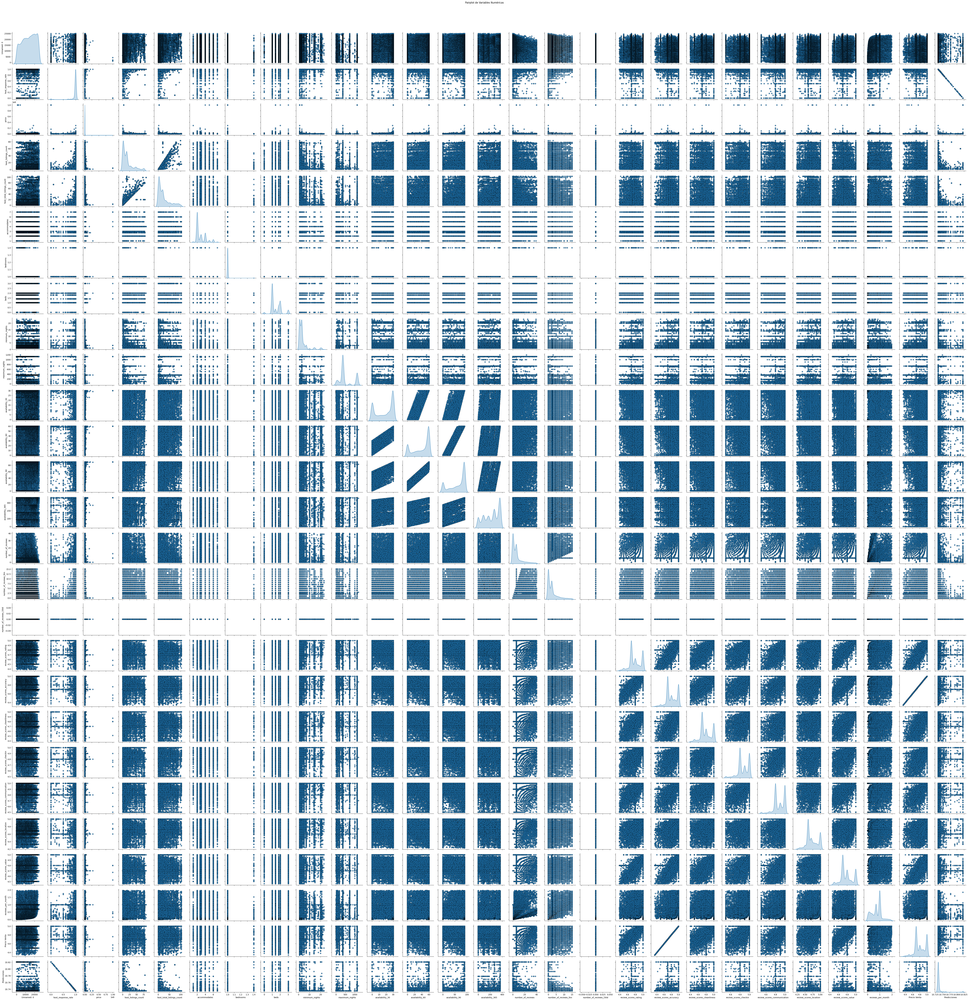

In [22]:
sns.pairplot(df, diag_kind='kde', plot_kws={'alpha': 0.8, 'edgecolor': 'k'})
plt.suptitle('Pairplot de Variables Numéricas', y=1.02)
plt.show()

In [23]:
df = df.drop(['host_acceptance_rate'], axis=1)
df.head()

,Unnamed: 0,host_response_rate,host_is_superhost,host_identity_verified,property_type,room_type,bathrooms_text,price,instant_bookable,host_listings_count,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones
0,0,1.00,f,t,Entire condo,Entire home/apt,1.5 baths,1793.0,f,2.0,...,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95,10.735359
8,8,0.75,f,t,Entire condo,Entire home/apt,1 bath,1369.0,f,2.0,...,4.88,4.71,4.82,4.81,4.69,4.50,4.80,0.11,4.71,10.756761
9,9,0.00,f,t,Entire rental unit,Entire home/apt,3.5 baths,5347.0,f,3.0,...,4.77,4.84,4.85,4.86,4.89,4.86,4.76,0.93,4.84,10.820968
13,13,1.00,f,t,Entire rental unit,Entire home/apt,1 bath,1090.0,f,2.0,...,4.80,4.56,4.80,4.90,4.90,4.35,4.80,0.47,4.56,10.735359
14,14,1.00,f,f,Entire condo,Entire home/apt,1 bath,2480.0,f,1.0,...,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70,10.735359


In [24]:
df = df.drop(['property_type'], axis=1)
df.head()

,Unnamed: 0,host_response_rate,host_is_superhost,host_identity_verified,room_type,bathrooms_text,price,instant_bookable,host_listings_count,host_total_listings_count,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones
0,0,1.00,f,t,Entire home/apt,1.5 baths,1793.0,f,2.0,2.0,...,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95,10.735359
8,8,0.75,f,t,Entire home/apt,1 bath,1369.0,f,2.0,4.0,...,4.88,4.71,4.82,4.81,4.69,4.50,4.80,0.11,4.71,10.756761
9,9,0.00,f,t,Entire home/apt,3.5 baths,5347.0,f,3.0,9.0,...,4.77,4.84,4.85,4.86,4.89,4.86,4.76,0.93,4.84,10.820968
13,13,1.00,f,t,Entire home/apt,1 bath,1090.0,f,2.0,11.0,...,4.80,4.56,4.80,4.90,4.90,4.35,4.80,0.47,4.56,10.735359
14,14,1.00,f,f,Entire home/apt,1 bath,2480.0,f,1.0,1.0,...,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70,10.735359


In [25]:
df = df.drop(['room_type'], axis=1)
df.head()

,Unnamed: 0,host_response_rate,host_is_superhost,host_identity_verified,bathrooms_text,price,instant_bookable,host_listings_count,host_total_listings_count,accommodates,...,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones
0,0,1.00,f,t,1.5 baths,1793.0,f,2.0,2.0,2.0,...,4.86,4.95,4.82,4.97,4.91,4.66,4.75,0.43,4.95,10.735359
8,8,0.75,f,t,1 bath,1369.0,f,2.0,4.0,2.0,...,4.88,4.71,4.82,4.81,4.69,4.50,4.80,0.11,4.71,10.756761
9,9,0.00,f,t,3.5 baths,5347.0,f,3.0,9.0,5.0,...,4.77,4.84,4.85,4.86,4.89,4.86,4.76,0.93,4.84,10.820968
13,13,1.00,f,t,1 bath,1090.0,f,2.0,11.0,2.0,...,4.80,4.56,4.80,4.90,4.90,4.35,4.80,0.47,4.56,10.735359
14,14,1.00,f,f,1 bath,2480.0,f,1.0,1.0,2.0,...,4.70,4.70,4.70,4.80,4.80,4.60,4.70,1.00,4.70,10.735359


In [26]:

import re

def extract_bathrooms(text):
    if pd.isna(text):
        return np.nan
    match = re.search(r"(\d+(?:\.\d+)?)", str(text))
    if match:
        return float(match.group(1))
    else:
        return np.nan

df['bathrooms'] = df['bathrooms_text'].apply(extract_bathrooms)




In [27]:
# prompt: tengo una columan que se llama host_identity_verified la cual tiene f y t entonces quiero cambiar el f por 0 y t por 1

# Replace 'f' with 0 and 't' with 1 in the 'host_identity_verified' column
df['host_identity_verified'] = df['host_identity_verified'].replace({'f': 0, 't': 1})


<ipython-input-27-db7f100e2a63>:4: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['host_identity_verified'] = df['host_identity_verified'].replace({'f': 0, 't': 1})


In [28]:
df['host_is_superhost'] = df['host_is_superhost'].replace({'f': 0, 't': 1})

<ipython-input-28-535d8996228b>:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['host_is_superhost'] = df['host_is_superhost'].replace({'f': 0, 't': 1})


In [29]:
df['instant_bookable'] = df['instant_bookable'].replace({'f': 0, 't': 1})

<ipython-input-29-02593409ee46>:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['instant_bookable'] = df['instant_bookable'].replace({'f': 0, 't': 1})


In [31]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('baths', '', regex=False)

In [33]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('bath', '', regex=False)

In [46]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('Half-bath', '.5', regex=False)

In [37]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('shared bath', '', regex=False)

In [39]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('private bath', '', regex=False)

In [50]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('', '', regex=False)

In [47]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('shared baths', '', regex=False)

In [55]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace(r'\D', ',', regex=True)

In [61]:
df['bathrooms_text'] = df['bathrooms_text'].astype(str)

In [62]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('00', '.', regex=False)

In [64]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('..', '', regex=False)

In [66]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('0', '', regex=False)

In [89]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('.', '', regex=False)

In [87]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace('', '', regex=False)

In [95]:
df['bathrooms_text'] = df['bathrooms_text'].str.replace(r'\s+', '', regex=True)

In [109]:
df['bathrooms_text'] = df['bathrooms_text'].replace('15.0', '1.5', regex=True)

In [98]:
df['bathrooms_text'] = pd.to_numeric(df['bathrooms_text'], errors='coerce')

In [106]:
df['bathrooms_text'] = df['bathrooms_text'].astype(float)

In [110]:
print(df['bathrooms_text'].head(20))

0     15.0
8      1.0
9     35.0
13     1.0
14     1.0
15     1.0
17     2.0
18    15.0
20     1.0
22     2.0
23     1.0
24     1.0
26     2.0
27     1.0
28     1.0
30     3.0
31     1.0
32     1.0
33     1.0
34     1.0
Name: bathrooms_text, dtype: float64


In [108]:
correlacion = df.corr()
correlacion

,Unnamed: 0,host_response_rate,host_is_superhost,host_identity_verified,bathrooms_text,price,instant_bookable,host_listings_count,host_total_listings_count,accommodates,...,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones,bathrooms
Unnamed: 0,1.000000,0.078656,-0.050868,0.218626,-0.076729,-0.017929,0.077974,0.194711,0.252597,-0.063220,...,-0.010059,0.035518,0.021033,-0.007001,0.037175,0.077940,0.256574,-0.010059,-0.078656,-0.006895
host_response_rate,0.078656,1.000000,0.165581,0.036066,0.015174,-0.089300,0.147488,0.084951,0.099825,0.008554,...,0.071263,0.045073,0.049959,0.066352,0.061758,0.043241,0.038698,0.071263,-1.000000,0.012995
host_is_superhost,-0.050868,0.165581,1.000000,0.150701,0.036243,-0.020468,-0.007772,-0.041151,-0.041745,0.015818,...,0.300491,0.228108,0.211949,0.270964,0.176406,0.203646,0.015506,0.300491,-0.165581,0.006202
host_identity_verified,0.218626,0.036066,0.150701,1.000000,0.010265,0.001150,0.172384,0.176489,0.180578,0.001804,...,0.087535,0.062295,0.052394,0.070476,0.077543,0.065536,-0.012113,0.087535,-0.036066,-0.003955
bathrooms_text,-0.076729,0.015174,0.036243,0.010265,1.000000,0.034623,0.019501,-0.083129,-0.076204,0.141732,...,0.031084,0.013142,0.019699,0.025075,0.004546,0.016918,-0.018247,0.031084,-0.015174,0.522645
price,-0.017929,-0.089300,-0.020468,0.001150,0.034623,1.000000,-0.022342,-0.025944,-0.030967,0.067029,...,-0.031232,-0.007378,-0.012507,-0.026910,-0.000119,-0.014669,-0.010338,-0.031232,0.089300,0.096382
instant_bookable,0.077974,0.147488,-0.007772,0.172384,0.019501,-0.022342,1.000000,0.244332,0.193278,0.035783,...,-0.001376,0.000948,-0.017908,-0.008613,0.035164,0.000505,0.041385,-0.001376,-0.147488,0.020074
host_listings_count,0.194711,0.084951,-0.041151,0.176489,-0.083129,-0.025944,0.244332,1.000000,0.746042,-0.019185,...,-0.076639,-0.058188,-0.049247,-0.082309,0.000206,-0.054490,0.047902,-0.076639,-0.084951,-0.083186
host_total_listings_count,0.252597,0.099825,-0.041745,0.180578,-0.076204,-0.030967,0.193278,0.746042,1.000000,-0.065243,...,-0.081879,-0.075326,-0.066261,-0.080989,-0.012368,-0.076937,0.055889,-0.081879,-0.099825,-0.090048
accommodates,-0.063220,0.008554,0.015818,0.001804,0.141732,0.067029,0.035783,-0.019185,-0.065243,1.000000,...,-0.024242,-0.021846,-0.005689,-0.015414,-0.002137,-0.012477,0.059538,-0.024242,-0.008554,0.315516


In [111]:
corr = abs(correlacion)
corr

,Unnamed: 0,host_response_rate,host_is_superhost,host_identity_verified,bathrooms_text,price,instant_bookable,host_listings_count,host_total_listings_count,accommodates,...,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,Precio Venta,Predicciones,bathrooms
Unnamed: 0,1.000000,0.078656,0.050868,0.218626,0.076729,0.017929,0.077974,0.194711,0.252597,0.063220,...,0.010059,0.035518,0.021033,0.007001,0.037175,0.077940,0.256574,0.010059,0.078656,0.006895
host_response_rate,0.078656,1.000000,0.165581,0.036066,0.015174,0.089300,0.147488,0.084951,0.099825,0.008554,...,0.071263,0.045073,0.049959,0.066352,0.061758,0.043241,0.038698,0.071263,1.000000,0.012995
host_is_superhost,0.050868,0.165581,1.000000,0.150701,0.036243,0.020468,0.007772,0.041151,0.041745,0.015818,...,0.300491,0.228108,0.211949,0.270964,0.176406,0.203646,0.015506,0.300491,0.165581,0.006202
host_identity_verified,0.218626,0.036066,0.150701,1.000000,0.010265,0.001150,0.172384,0.176489,0.180578,0.001804,...,0.087535,0.062295,0.052394,0.070476,0.077543,0.065536,0.012113,0.087535,0.036066,0.003955
bathrooms_text,0.076729,0.015174,0.036243,0.010265,1.000000,0.034623,0.019501,0.083129,0.076204,0.141732,...,0.031084,0.013142,0.019699,0.025075,0.004546,0.016918,0.018247,0.031084,0.015174,0.522645
price,0.017929,0.089300,0.020468,0.001150,0.034623,1.000000,0.022342,0.025944,0.030967,0.067029,...,0.031232,0.007378,0.012507,0.026910,0.000119,0.014669,0.010338,0.031232,0.089300,0.096382
instant_bookable,0.077974,0.147488,0.007772,0.172384,0.019501,0.022342,1.000000,0.244332,0.193278,0.035783,...,0.001376,0.000948,0.017908,0.008613,0.035164,0.000505,0.041385,0.001376,0.147488,0.020074
host_listings_count,0.194711,0.084951,0.041151,0.176489,0.083129,0.025944,0.244332,1.000000,0.746042,0.019185,...,0.076639,0.058188,0.049247,0.082309,0.000206,0.054490,0.047902,0.076639,0.084951,0.083186
host_total_listings_count,0.252597,0.099825,0.041745,0.180578,0.076204,0.030967,0.193278,0.746042,1.000000,0.065243,...,0.081879,0.075326,0.066261,0.080989,0.012368,0.076937,0.055889,0.081879,0.099825,0.090048
accommodates,0.063220,0.008554,0.015818,0.001804,0.141732,0.067029,0.035783,0.019185,0.065243,1.000000,...,0.024242,0.021846,0.005689,0.015414,0.002137,0.012477,0.059538,0.024242,0.008554,0.315516


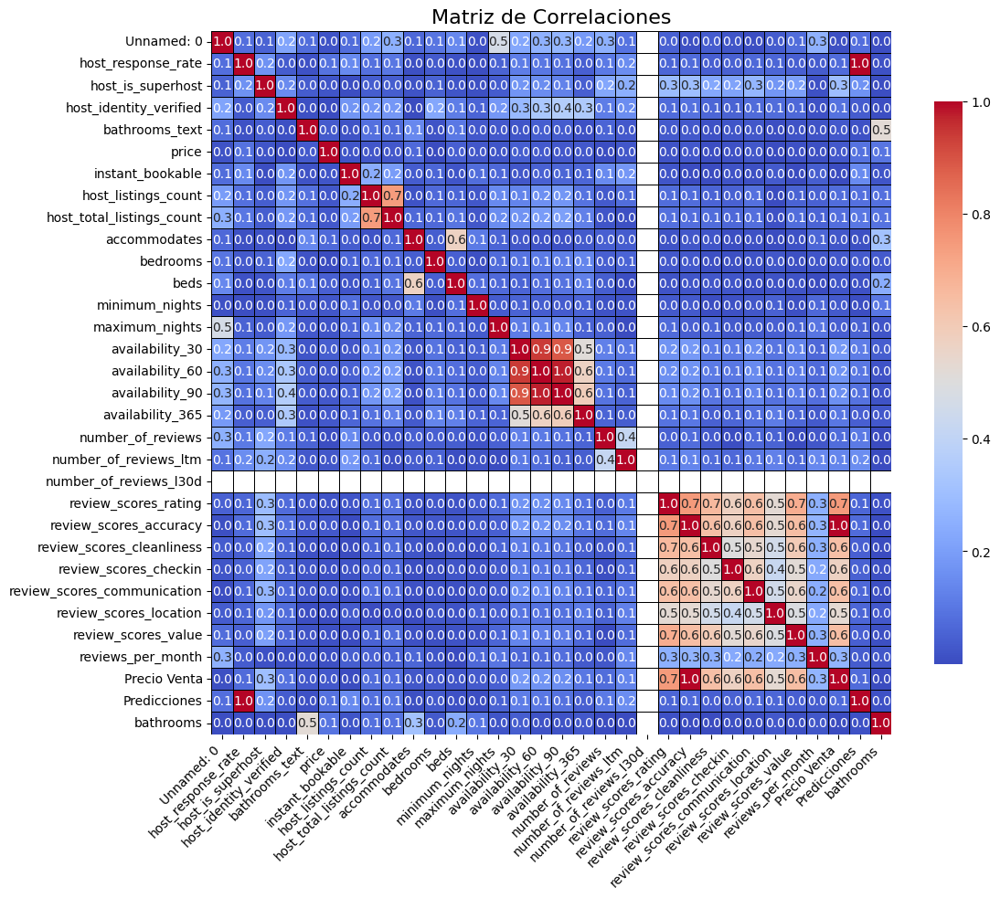

In [113]:
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt='.1f', linewidths=0.5, linecolor='black', cbar_kws={'shrink': 0.8}, annot_kws={"size": 10})
plt.title('Matriz de Correlaciones', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(rotation=0, fontsize=10)
plt.show()